In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import seaborn as sns
import matplotlib
import matplotlib as mpl
from matplotlib import pyplot as plt
%matplotlib inline

pd.pandas.set_option('display.max_columns',None)
pd.pandas.set_option('display.max_rows',None)
import warnings
warnings.filterwarnings('ignore')
import missingno as msno

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/weather-dataset-rattle-package/weatherAUS.csv


In [2]:
data = pd.read_csv('../input/weather-dataset-rattle-package/weatherAUS.csv')
df = data.copy()
df.head()

# This function returns the first n rows for the object based on position. 
# It is useful for quickly testing if your object has the right type of data in it.
# n = int, default 5

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [3]:
df.info()

# This method prints information about a DataFrame including the index dtype and columns, non-null values and memory usage.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [4]:
df.describe(include = 'all').T

# include = 'all' : All columns of the input will be included in the output.

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Date,145460,3436,2016-11-05,49,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Location,145460,49,Canberra,3436,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MinTemp,143975.0,NaN,NaN,NaN,12.194034,6.398495,-8.5,7.6,12.0,16.9,33.9
MaxTemp,144199.0,NaN,NaN,NaN,23.221348,7.119049,-4.8,17.9,22.6,28.2,48.1
Rainfall,142199.0,NaN,NaN,NaN,2.360918,8.47806,0.0,0.0,0.0,0.8,371.0
Evaporation,82670.0,NaN,NaN,NaN,5.468232,4.193704,0.0,2.6,4.8,7.4,145.0
Sunshine,75625.0,NaN,NaN,NaN,7.611178,3.785483,0.0,4.8,8.4,10.6,14.5
WindGustDir,135134,16,W,9915,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WindGustSpeed,135197.0,NaN,NaN,NaN,40.03523,13.607062,6.0,31.0,39.0,48.0,135.0
WindDir9am,134894,16,N,11758,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# MissingNo visualizations

Pandas provides functions to check the number of missing values in the dataset. Missingno library takes it one step further and provides the distribution of missing values in the dataset by informative visualizations. Using the plots of missingno, we are able to see where the missing values are located in each column and if there is a correlation between missing values of different columns.

In [5]:
miss = df.isnull().sum().sort_values(ascending = False)
miss_per = (miss/len(df))*100
pd.DataFrame({'MissingNo_records': miss, 'percentage of missing data': miss_per.values})

,MissingNo_records,percentage of missing data
Sunshine,69835,48.009762
Evaporation,62790,43.166506
Cloud3pm,59358,40.807095
Cloud9am,55888,38.421559
Pressure9am,15065,10.356799
Pressure3pm,15028,10.331363
WindDir9am,10566,7.263853
WindGustDir,10326,7.098859
WindGustSpeed,10263,7.055548
Humidity3pm,4507,3.098446


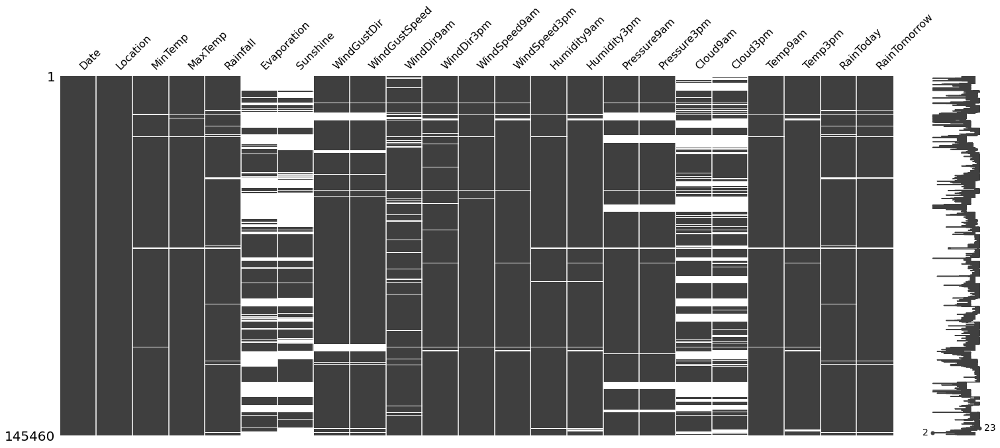

In [6]:
msno.matrix(df);

# White lines indicate missing values.

<AxesSubplot:>

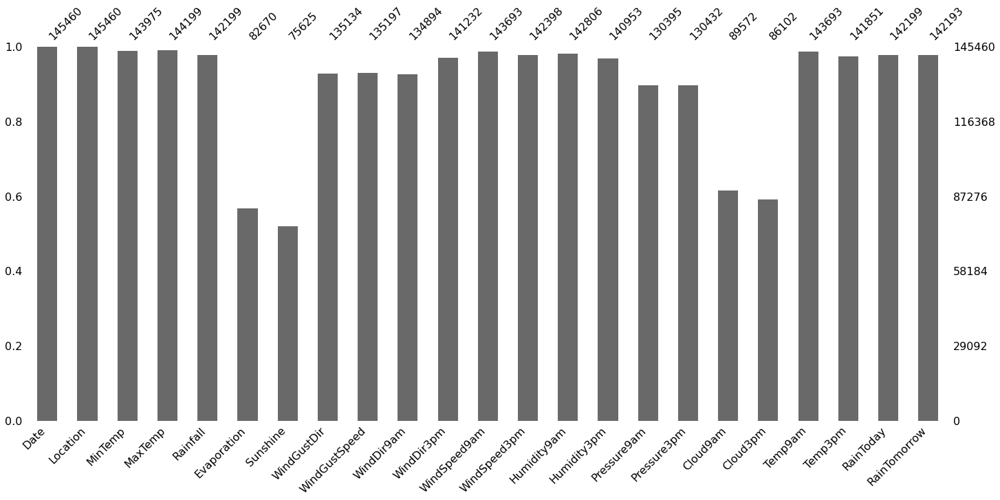

In [7]:
msno.bar(df)

<AxesSubplot:>

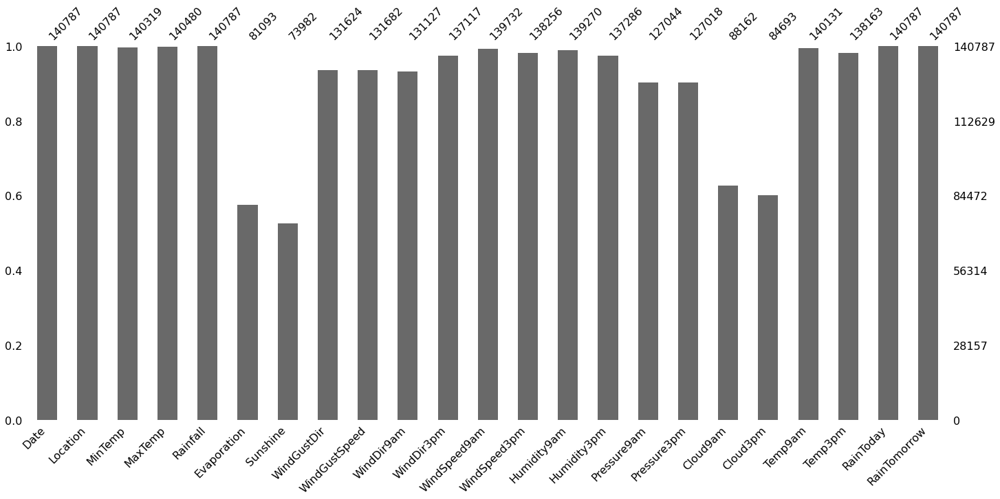

In [8]:
df = df.dropna(subset = ['RainTomorrow', 'RainToday']) 
# df.dropna is the canonical method to drop NaNs from DataFrames.
msno.bar(df)

# Frequency of categorical variables with histogram

In [9]:
df['Date'] = pd.to_datetime(df['Date'], format = '%Y-%m-%d')

# Convert argument to datetime.

df['Year'] = df['Date'].dt.year.astype('int16')
df['Month'] = df['Date'].dt.month.astype('int16')
df['Year_and_Month'] = df['Date'].array.strftime('%Y-%m')
df['Different_Temp'] = df['MaxTemp']-df['MinTemp']
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Year_and_Month,Different_Temp
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,2008,12,2008-12,9.5
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,2008,12,2008-12,17.7
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,2008,12,2008-12,12.8
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,2008,12,2008-12,18.8
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,2008,12,2008-12,14.8


In [10]:
a = 0
def figure():
    global a
    a += 1
    return 'Tables and Graphs_'+str(a)

In [11]:
categorical_variables = [i for i in df.columns if df[i].dtype == 'object']

In [12]:
for i in categorical_variables[:-1]:
    Tables_Graphs = figure()
    Tables_Graphs = px.histogram(df, x = i,title = f"Tables and Graphs_{a}: Frequency of {i}")
    Tables_Graphs.update_xaxes(categoryorder = 'total ascending')
    Tables_Graphs.show()

# Distribution of numerical variables with histogram and boxplot/violin

In [13]:
Tables_Graphs_ = figure()
Tables_Graphs = px.histogram(df, x='Year_and_Month', color = 'RainToday',
                    title = f"Tables_Graphs_{a}: Rainy Day Distribution in Year_and_Month Time Series")
Tables_Graphs.show()

In [14]:
num_variables = [i for i in df.columns if df[i].dtype!='object']

In [15]:
cls_1=[
 'Different_Temp',
 'MaxTemp',
 'MinTemp',
 'Evaporation',
 'Sunshine',
 'WindGustDir',
 'WindGustSpeed',
]

In [16]:
for i in cls_1:
    Tables_Graphs = figure()
    Tables_Graphs = px.violin(df, x = i, color='RainTomorrow',title = f"Tables_Graphs_{a}: Violinplot of {i}")
    Tables_Graphs.show()

    Tables_Graphs = figure()
    Tables_Graphs = px.histogram(df, x = i, color='RainTomorrow',title = f"Tables_Graphs_{a}: Frequency Distribution of {i}")
    Tables_Graphs.show()

# Heatmap for Correlation

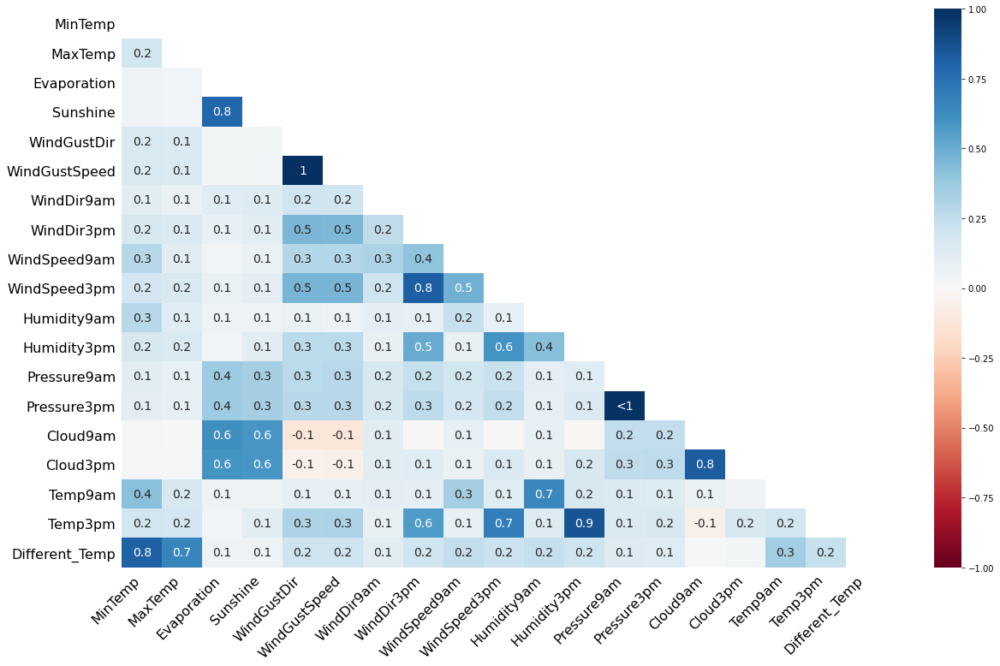

In [17]:
msno.heatmap(df);

- The correlations between Temp3pm-Humidity3pm(0.9), Cloud3pm-Cloud9am(0.8), Windspeed3pm-WindDir3pm(0.8) and Sunshine-Evaporation(0.8) are high.

# Scatter matrix and/or OLS Scatter Plot for numerical variables
- Additionally RainToday and RainTomorrow variables as color dimension

In [18]:
cls_1=[
 'MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'Different_Temp',
 'Year',
 'Month']

In [19]:
df_0 = df.drop(['Date'],axis = 1).groupby(['Year_and_Month','RainTomorrow'])[cls_1].mean().reset_index()

In [20]:
 cls_2=[
         ('MinTemp', 'MaxTemp'),
         ('Different_Temp', 'Evaporation'),
         ('Different_Temp', 'Sunshine'),
         ('Different_Temp', 'Humidity9am'),
         ('Different_Temp', 'Pressure9am'),
         ('MaxTemp', 'Rainfall'),
         ('Rainfall', 'Evaporation'),
         ('Rainfall', 'Sunshine'),
         ('Rainfall', 'WindSpeed9am'),
         ('Rainfall', 'Humidity9am'),
         ('Rainfall', 'Pressure9am')]

In [21]:
for pair in cls_2:
    Tables_Graphs = figure()
    Tables_Graphs = px.scatter(df_0, x = pair[0], y = pair[1],title = f"fig_{a}: Scatterplot of {pair}",
                     trendline = "ols",
                     color = 'RainTomorrow',
                     trendline_color_override="green")
    Tables_Graphs.show()

# Time series (preferably monthly) line chart for numerical variables
- RainToday and RainTomorrow variables as 3rd variable with color dimension
- Tip: Use groupby method to group by month/year and calculate mean values

In [22]:
cls_1 = ['MinTemp', 'MaxTemp', 'Different_Temp','Rainfall', 'Evaporation',
       'Sunshine','WindGustSpeed','WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm']

In [23]:
df1 = df_0.groupby(['Year_and_Month','RainTomorrow'])[cls_1].agg('mean').reset_index()
df2 = df_0.groupby(['Month','RainTomorrow'])[cls_1].agg('mean').reset_index()
df3 = df_0.groupby(['Year','RainTomorrow'])[cls_1].agg('mean').reset_index()

In [24]:
for i in cls_1:
    Tables_Graphs = figure()
    Tables_Graphs = px.line(df1, x='Year_and_Month', y = i, title = f"Tables_Graphs_{a}: Lineplot of {i}",
                     color='RainTomorrow',
                 )
    Tables_Graphs.show()

In [25]:
for i in cls_1:
    Tables_Graphs = figure()
    Tables_Graphs = px.line(df2, x = 'Month', y = i, title = f"Tables_Graphs_{a}: Lineplot of {i}",
                     color = 'RainTomorrow',
                 )
    Tables_Graphs.show()

In [26]:
for i in cls_1:
    Tables_Graphs = figure()
    Tables_Graphs = px.line(df3, x = 'Year', y = i, title = f"Tables_Graphs_{a}: Lineplot of {i}",
                     color='RainTomorrow',
                 )
    Tables_Graphs.show()

Tables_Graphs

# Polar/Radar chart for numerical variables and Wind Direction as the 2nd variable
- Tip: Use groupby method and calculate mean values

In [27]:
df4 = df[df.RainTomorrow == 'Yes'].groupby('WindGustDir')[cls_1].agg('mean').reset_index()
df5 = df[df.RainTomorrow == 'No'].groupby('WindGustDir')[cls_1].agg('mean').reset_index()

In [28]:
import plotly.graph_objects as go

categories = df4.WindGustDir.unique()

for i in cls_1:
    Tables_Graphs = figure()
    Tables_Graphs = go.Figure()

    Tables_Graphs.add_trace(go.Scatterpolar(
          r = df4[i],
          theta = categories,
          fill = 'toself',
          name = 'Product A'
    ))
    Tables_Graphs.add_trace(go.Scatterpolar(
          r = df5[i],
          theta = categories,
          fill = 'toself',
          name = 'Product B'
    ))

    Tables_Graphs.update_layout(
      polar = dict(
        radialaxis = dict(
          visible = True,
          range = [min(df4[i].min(),df5[i].min()),
                 max(df4[i].max(),df5[i].max())]
        )),
      title = {
        'text': f"Tables_Graphs_{a}: Radarplot of {i}",
        'y':0.9,'x':0.5,
        'xanchor': 'center','yanchor': 'top'},
      showlegend = False
    )

    Tables_Graphs.show()